# 16. 프로젝트 : SRGAN 활용하기
앞에서 사용했던 SRGAN 구조를 이용해 프로젝트를 수행해 봅시다.

## 이론 정리(노드 및 참고문헌 참조)

### Super Resolution(SR)    
저해상도 영상을 고해상도 영상으로 변환하는 작업 또는 과정이다. 
- SR의 문제점
1. Ill-posed(Inverse) problem     
하나의 저해상도 이미지에 대해 여러 개의 고해상도 이미지가 나올 수 있다. 눈으로 볼 때는 차이가 거의 없지만 세부적으로 픽셀의 값이 다를 수 있다. 

<img src="https://images.velog.io/images/guide333/post/87780a4a-7529-4a8a-8add-d5fca29714c2/Screenshot%20from%202021-03-09%2010-26-58.png" width="200px" height="200px">

2. SR 문제의 복잡도   
제한된 정보만을 이용해 많은 정보를 만들어내는 과정은 복잡하고 잘못된 정보를 만들 가능성이 높다. 이 문제는 원래 가진 이미지의 해상도보다 더 높은 해상도로 SR할수록 점점 심해진다. 

또한 SR의 정량적 평가 척도와 사람이 시각적으로 관찰해 내란 평가가 일치하지 않는다. 

SR의 정량적 평가 척도는 RSNR(Peak Signal-to-Noise Ratio)와 SSIM(Structural Similarity Index Map)이 있다. RSNR은 영상을 압축했을 때 화질이 얼마나 손실되었는지 평가하는 목적으로 사용되며 SSIM은 영상의 구조 정보를 고려해 얼마나 구조 정보를 변화시키지 않았는지를 계산한다. 따라서 두 개의 정량적 평가척도가 높을수록 원본 영상의 품질에 가깝다. 일반적으로 SR은 회복된 고해상도 이미지와 원본 이미지의 MSE를 최소화하는 것이다. 하지만 MSE와 PSNR은 pixel-wise image의 차이 기반으로 정의되었기 때문에 High texture detail같이 지각적으로 관련된 차이를 제대로 파악하지 못한다. (왼쪽의 수치값: PSNR, 오른쪽의 수치값: SSIM)
 
![](https://images.velog.io/images/guide333/post/9c1bf7a9-fe2a-487b-8890-2ec1f032f826/Screenshot%20from%202021-03-14%2014-41-39.png)

### Interpolation
보간법이라고 불리는 Interpolation은 SR을 하는 가장 쉬운 방식이다. 이 프로젝트에서 사용된 Bicubic Interpolation은 삼차보간법(Cubic Interpoliation)을 2차원으로 확장한 것으로 16개의 점을 참조한다. (삼차보간법은 두 점이 삼차함수 그래프 위에 있다고 가정하여 4개의 미지수를 풀기 위해 두 점을 넣어 2개의 식을 만들고 삼차함수를 미분해 두 점을 대입해 2개의 식을 더 만든다. 이 네 개의 점을 참조하여 삼차함수의 식을 구한 후, 그 식을 이용하여 그 값을 추정한다.) 아래의 그림은 다양한 보간법의 그래프이다. 

![](https://images.velog.io/images/guide333/post/2f7999b8-c36b-4e34-955a-c4be53f8b3f7/Screenshot%20from%202021-03-14%2014-18-13.png)

아래의 그림은 {\displaystyle [0,4]\times [0,4]}의 구역을 Bicubic Interpolation을 사용해 표현한 것이다. 색은 함수값이고 점은 기존 이미지의 위치를 의미한다. 

<img src="https://images.velog.io/images/guide333/post/30e9020e-3e86-48ca-a5b5-ac02823364fb/Screenshot%20from%202021-03-14%2014-18-23.png" width="300px" height="300px">

(위의 두 사진은 [위키피디아](https://en.wikipedia.org/wiki/Bicubic_interpolation#:~:text=In%20mathematics%2C%20bicubic%20interpolation%20is,a%20two%2Ddimensional%20regular%20grid.) 에서 참조하였음)

### SRGAN
MSE는 pixel-wise average loss, 즉 loss를 평균을 내기 때문에 과하게 smooth하고, 결국 시각적으로 좋은 성능을 내지 못한다. 그러나 GAN은 원본 이미지에게 특징을 추출해 새로운 이미지를 생성하므로 더 좋은 결과를 낸다. 

![](https://images.velog.io/images/guide333/post/a953108e-3dcd-404d-9a95-1317b43a1778/Screenshot%20from%202021-03-14%2014-52-47.png)

SRGAN은 GAN(Generative Adversarial Networks)을 활용한 SR이다. 구조는 아래와 같다. 

![](https://images.velog.io/images/guide333/post/e4189ff5-e3cf-4787-8ae7-f1b0b23cc7d8/Screenshot%20from%202021-03-09%2015-44-57.png)

모델 구조에서 보듯 SRGAN은 CNN을 거쳐 픽셀의 수를 늘린다. 픽셀을 늘리는 방식은 sub-pixel convolution algorithm을 이용한 것이다. 즉 입력 이미지의 feature map을 조합해 pixel 수를 늘린다. 그림은 다음과 같다. 

![](https://images.velog.io/images/guide333/post/64e82f9f-bd66-49fe-bb47-253b090c0fd1/Screenshot%20from%202021-03-14%2014-58-10.png)

SRGAN에서 사용하는 Loss function은 아래와 같다. 

![](https://images.velog.io/images/guide333/post/3a5e054f-e1dc-45fb-bb05-f7bf9c5cfdb1/Screenshot%20from%202021-03-09%2015-46-14.png)

Perceptual Loss는 크게 content loss와 adversarial loss로 이루어져 있고 adversarial loss는 GAN loss이다. 그러나 content loss는 각 이미지를 이미지넷으로 사전학습된 VGG모델에 입력해 나오는 Feature map에서의 차이를 계산한 것이다. 즉 SRGAN에서 생성된 고해상도 이미지와 실제 고해상도 이미지를 VGG에 입력하여 모델 중간에서 추출해낸 특징을 비교해 loss를 계산한다. 그 과정이 아래의 그림이다.

![](https://images.velog.io/images/guide333/post/aeda45c5-21fc-4d16-ad59-1361869cb1df/Screenshot%20from%202021-03-09%2015-46-46.png)

VGG모델을 사용한 SRGAN은 GAN과 VGG 구조를 사용하여 이미지 내 세부적인 구조를 보다 선명하게 생성한다. 

- 참고: [SRGAN 리뷰](https://leedakyeong.tistory.com/entry/%EB%85%BC%EB%AC%B8Photo-Realistic-Single-Image-Super-Resolution-Using-a-Generative-Adversarial-NetworkSRGAN)


## 순서
1. 프로젝트 1 : 직접 고른 이미지로 SRGAN 실험하기
2. 프로젝트 2 : SRGAN을 이용해 고해상도 gif 생성하기

### 프로젝트 1 : 직접 고른 이미지로 SRGAN 실험하기
이제 여러분이 직접 다른 이미지를 사용해 볼 차례입니다.

앞서 사용했던 DIV2K 데이터셋은 bicubic interpolation을 이용해 가로 및 세로 픽셀 수를 1/4로 줄인 저해상도 이미지와 원래 고해상도 이미지 사이에서 학습되었습니다. 이 데이터셋으로 학습된 SRGAN를 이용해 좋은 결과를 얻기 위해서는 위와 같은 과정이 동일하게 진행되는 것이 좋습니다.

아래와 같이 두 가지 다른 단계를 거쳐서 직접 고른 이미지에 대해 SRGAN을 적용해 봅시다. (모델 학습을 진행하는 건 아닙니다❗) 테스트할 이미지를 고를 때, DIV2K 의 학습 데이터셋과 비슷한 종류의 이미지가 좋습니다. 일반적으로 자연, 동물, 건물 등의 이미지가 학습에 사용되었으며, 이와 달리 애니메이션 등의 이미지는 고해상도로 잘 변환되지 않을 수 있습니다.

특정 데이터셋에서만 학습되었기 때문에, 일반적으로 좋지 않은 결과가 나올 가능성이 높습니다. 결과와 상관없이 아래 과정만 잘 수행해봅시다.

#### 프로젝트 1-1.

1. (적당히) 높은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.

In [1]:
# import library

import matplotlib.pyplot as plt
import cv2
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras import Input, Model
from tensorflow.python.keras import applications
from PIL import Image

Duplicate key in file PosixPath('/home/aiffel-dj44/Downloads/aiffel/envs/aiffel/lib/python3.7/site-packages/matplotlib/mpl-data/matplotlibrc'), line 253 ('font.family:  sans-serif')


(853, 1280, 3)


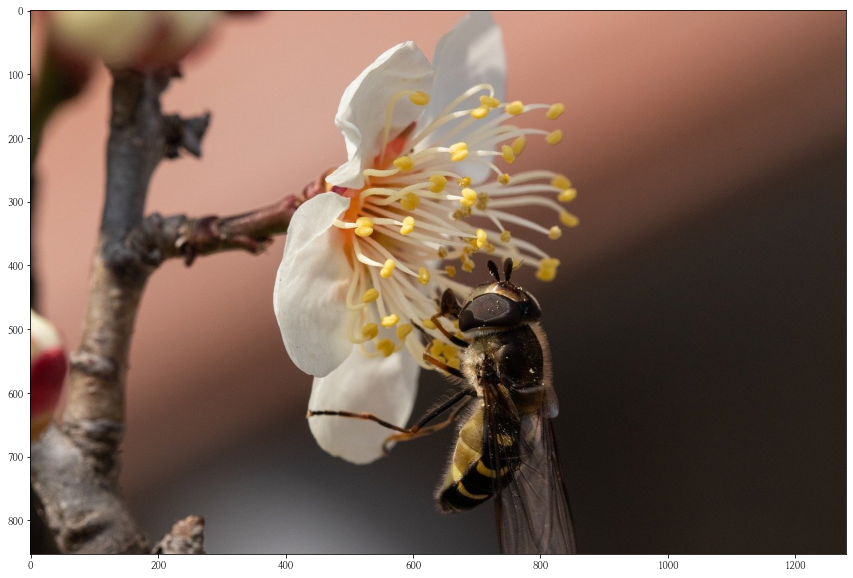

In [2]:
image_path = os.getenv('HOME') + '/aiffel/super_resolution/b.jpg'
hr = cv2.imread(image_path)
hr = cv2.cvtColor(hr, cv2.COLOR_BGR2RGB)

print(hr.shape)
plt.figure(figsize=(25, 10))
plt.imshow(hr)
plt.show()

불러온 이미지의 크기는 427x640x3이다. 

2. 불러온 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 1/4로 줄입니다. cv2.resize()를 사용해 봅시다.

여기서 중요한 것은 위의 이미지의 사이즈는 (세로 픽셀수 x 가로 픽셀수 x 채널수)이지만 opencv 라이브러리의 resize()를 이용하려면 이미지의 크기를 (가로 픽셀수, 세로 픽셀수)로 지정해주어야 한다는 것이다. 

(213, 320, 3)


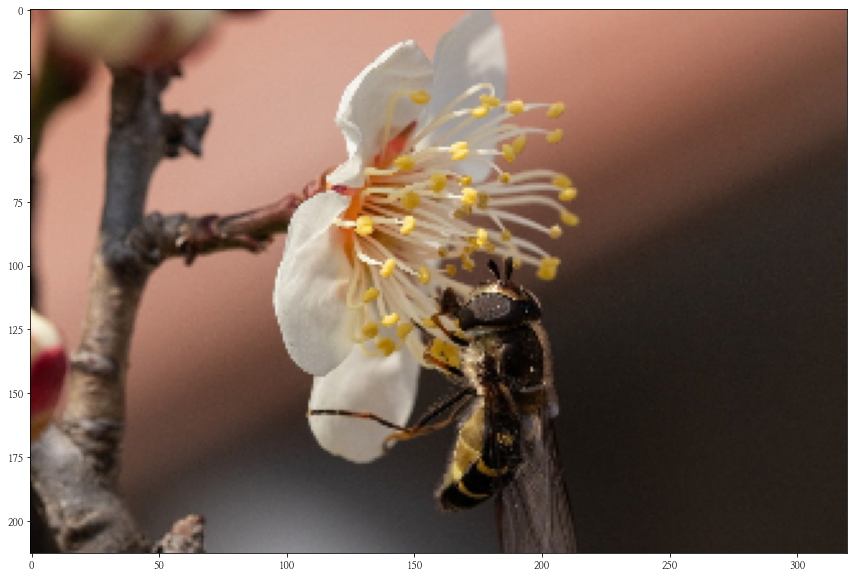

In [3]:
lr = cv2.resize(hr, dsize=(hr.shape[1]//4, hr.shape[0]//4))  # (가로 픽셀수, 세로 픽셀수)
print(lr.shape)

plt.figure(figsize=(25, 10))
plt.imshow(lr)

3. 줄인 저해상도 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성합니다. 이전에 사용한 apply_srgan 함수를 사용하면 쉽습니다.

SRGAN이 만족스러운 결과를 도출할 때까지는 상당히 많은 학습 시간을 요구하므로 학습이 완료된 SRGAN을 이용해 테스트한다.

SRGAN은 크게 두 개의 신경망(Generator, Discriminator)으로 구성되어 있지만, 테스트에는 저해상도 입력을 넣어 고해상도 이미지를 출력하는 Generator만 이용한다. 아래 srgan_G.h5 파일은 학습이 완료된 Generator이고, 이를 다운로드받아 코드를 실행해 학습 완료된 모델을 불러온다.

```python
$ wget https://aiffelstaticprd.blob.core.windows.net/media/documents/srgan_G.h5
$ mv srgan_G.h5 ~/aiffel/super_resolution
```

In [4]:
model_file = os.getenv('HOME')+'/aiffel/super_resolution/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)

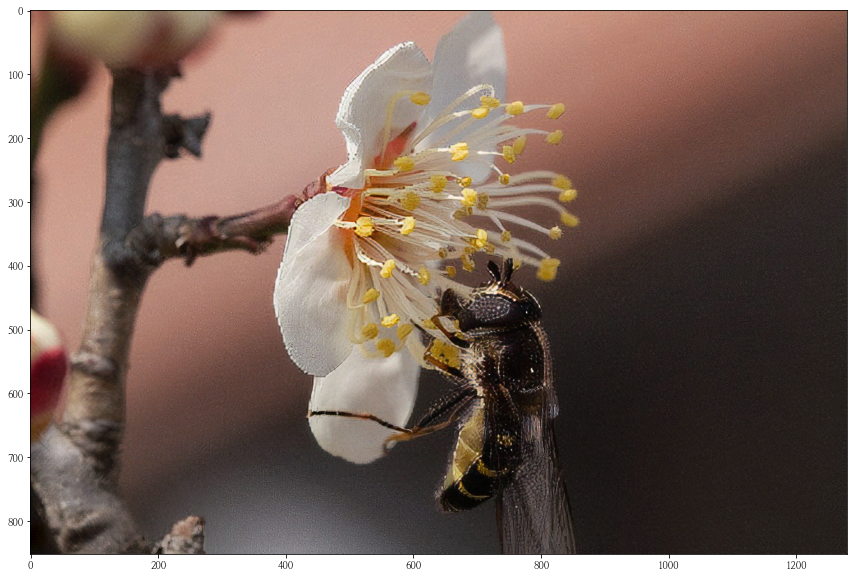

In [5]:
def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

srgan_hr = apply_srgan(lr)

# 시각화
plt.figure(figsize=(20,10))
plt.imshow(srgan_hr)

4. 2.의 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. 마찬가지로 cv2.resize()를 사용해 봅시다.

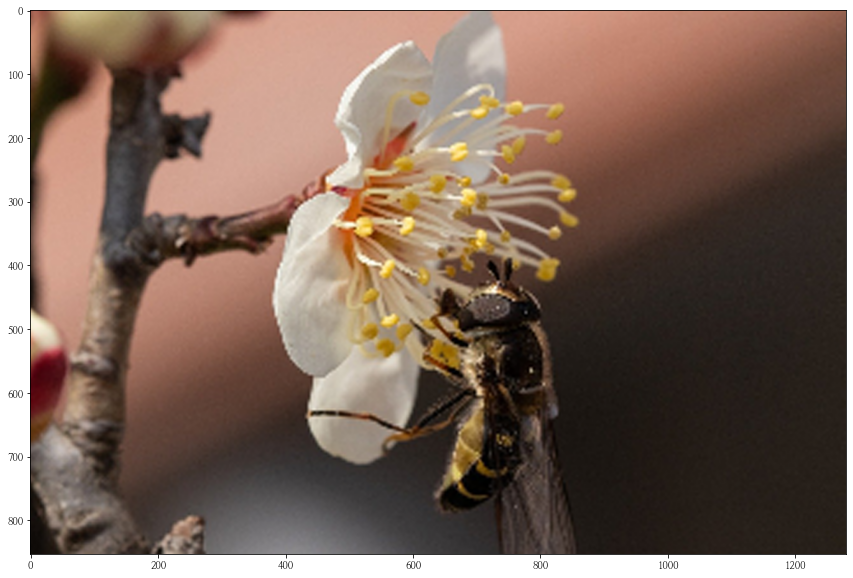

In [6]:
# 저해상도 이미지를 고해상도 이미지 크기로 bicubic interpolation
hr, lr = np.array(hr), np.array(lr)  
bicubic_hr = cv2.resize(
     lr,
     dsize=(hr.shape[1], hr.shape[0]),    # 고해상도 이미지 크기로 설정
     interpolation=cv2.INTER_CUBIC)        # bicubic 설정


# 시각화
plt.figure(figsize=(20,10))
plt.imshow(bicubic_hr)

5. 3개 이미지(4.의 Bicubic의 결과, 3.의 SRGAN의 결과, 1.의 원래 고해상도 이미지)를 나란히 시각화합니다. 각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.

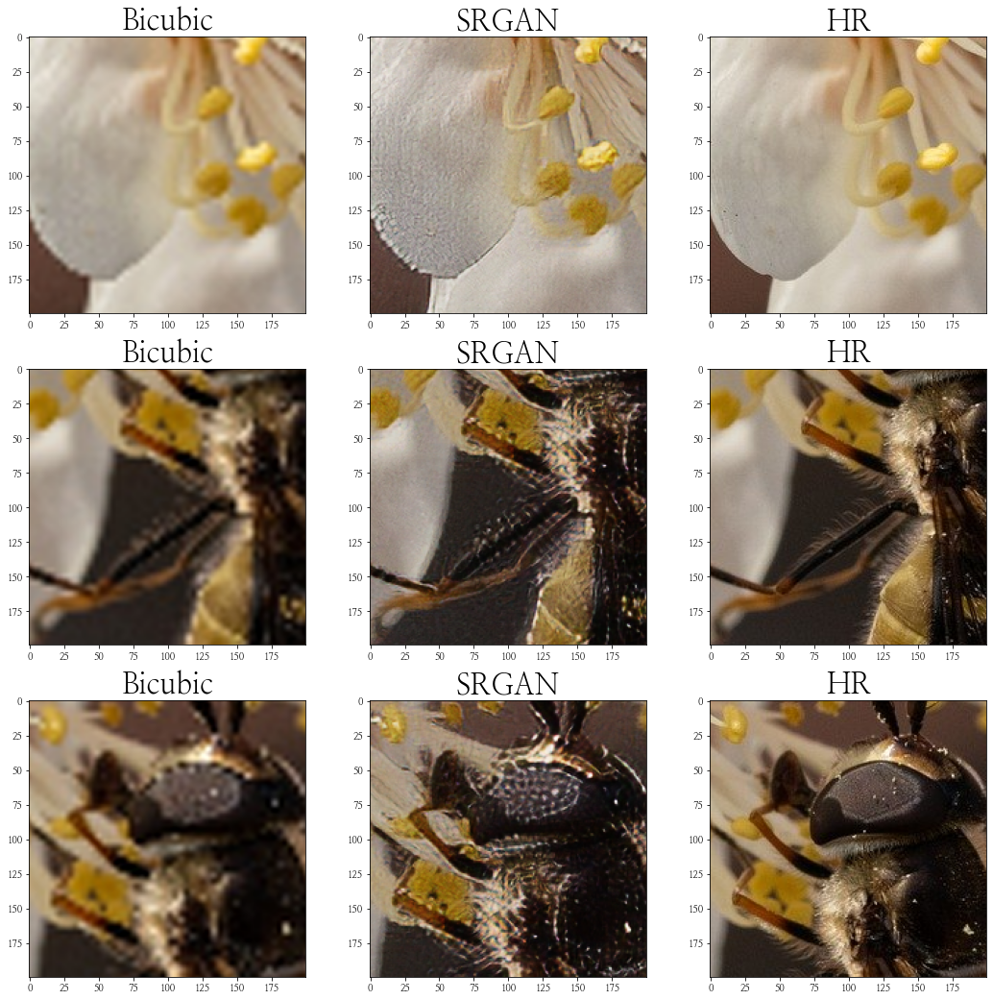

In [7]:
def crop(image, left_top, x=100, y=200):
    return image[left_top[0]:(left_top[0]+x), left_top[1]:(left_top[1]+y), :]

# 자세히 시각화 하기 위해 3개 영역을 잘라냅니다.
# 아래는 잘라낸 부분의 좌상단 좌표 3개 입니다.
left_tops = [(400,400), (500,550), (400,600)]

images = []
for left_top in left_tops:
    img1 = crop(bicubic_hr, left_top, 200, 200)
    img2 = crop(srgan_hr , left_top, 200, 200)
    img3 = crop(hr, left_top, 200, 200)
    images.extend([img1, img2, img3])

labels = ["Bicubic", "SRGAN", "HR"] * 3

plt.figure(figsize=(18,18))
for i in range(9):
    plt.subplot(3,3,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

조금 더 작은 이미지를 넣어 보았다. 

In [8]:
image_path = os.getenv('HOME') + '/aiffel/super_resolution/0.jpg'
hr = cv2.imread(image_path)
hr = cv2.cvtColor(hr, cv2.COLOR_BGR2RGB)

print(hr.shape)

(427, 640, 3)


불러온 이미지의 크기는 427x640x3이다.

In [9]:
lr = cv2.resize(hr, dsize=(hr.shape[1]//4, hr.shape[0]//4))  # (가로 픽셀수, 세로 픽셀수)
print(lr.shape)

(106, 160, 3)


In [10]:
srgan_hr = apply_srgan(lr)

In [11]:
# 저해상도 이미지를 고해상도 이미지 크기로 bicubic interpolation
hr, lr = np.array(hr), np.array(lr)  
bicubic_hr = cv2.resize(
     lr,
     dsize=(hr.shape[1], hr.shape[0]),    # 고해상도 이미지 크기로 설정
     interpolation=cv2.INTER_CUBIC)        # bicubic 설정


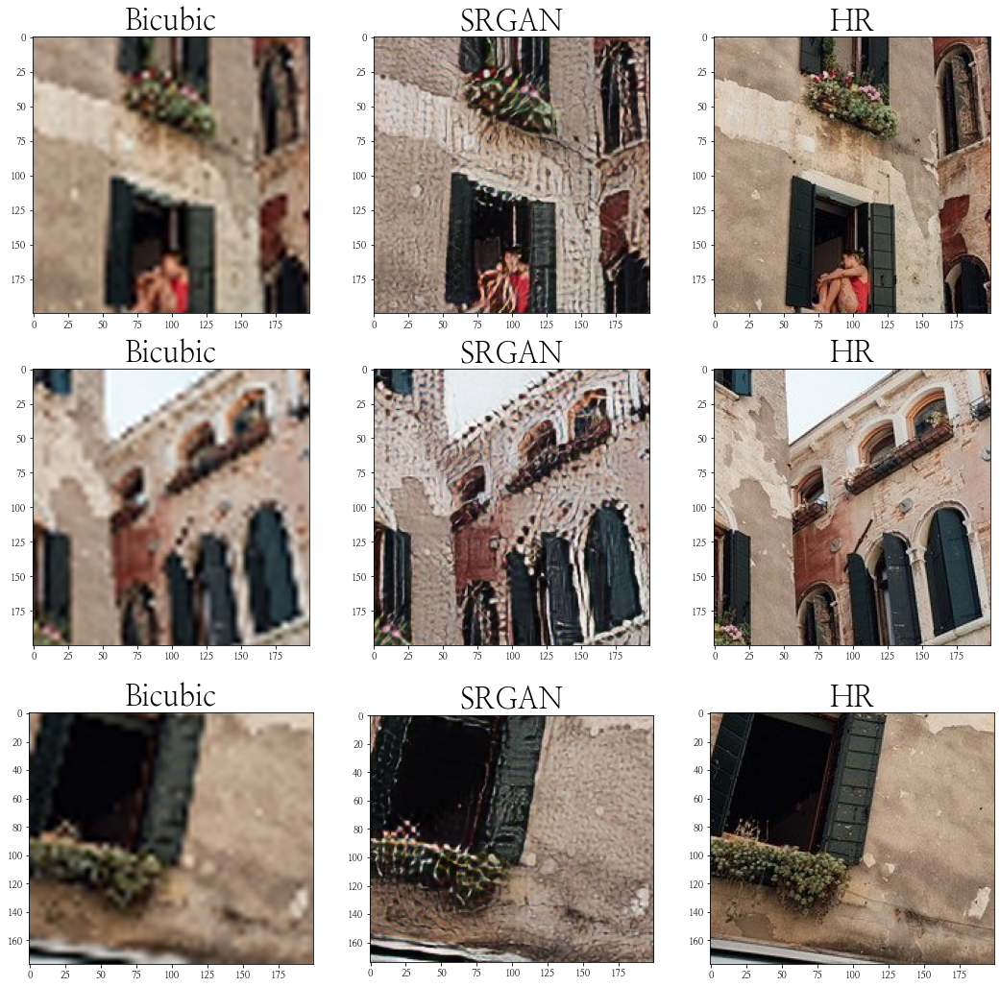

In [12]:
# 자세히 시각화 하기 위해 3개 영역을 잘라냅니다.
# 아래는 잘라낸 부분의 좌상단 좌표 3개 입니다.
left_tops = [(200,200), (50,300), (250,0)]

images = []
for left_top in left_tops:
    img1 = crop(bicubic_hr, left_top, 200, 200)
    img2 = crop(srgan_hr , left_top, 200, 200)
    img3 = crop(hr, left_top, 200, 200)
    images.extend([img1, img2, img3])

labels = ["Bicubic", "SRGAN", "HR"] * 3

plt.figure(figsize=(18,18))
for i in range(9):
    plt.subplot(3,3,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

6. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution했을 때 어떠한 결과가 나왔으며, 왜 이러한 결과가 출력되었는지 설명해 봅시다. (정답은 없습니다)

SRGAN을 사용했을 때 생성된 이미지는 Bicubic으로 interpolation 한 것보다는 선명하게 보이나 이미지가 매끄럽지 않다(벌의 털이나 눈 부분, 건물의 벽, 식물 등). 작게 나온 사람의 경우는 팔이나 다리가 제대로 표현되지 않았다. 

이 [논문](https://arxiv.org/pdf/1903.09922.pdf)에서는 SRGAN은 모델이 학습한 데이터셋과 비슷한 입력 데이터를 넣었을 때 좋은 결과를 내었다고 한다. 사람의 얼굴이 들어간 데이터셋을 사용한 모델은 사람의 얼굴을 더 잘 생성하였고, 사람의 얼굴이 아닌 다른 것들에서는 제대로 이미지를 생성하지 않았다고 한다. 

위의 논문의 결과에 따르면 이번 프로젝트의 SRGAN 모델이 학습할 때 사용한 데이터셋이 위의 입력 이미지와 달랐을 것이라고 추측할 수 있다. 

#### 프로젝트 1-2.

1. (적당히) 낮은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.

낮은 해상도를 가진 이미지를 찾기 힘들어서 사이즈를 줄여서 저장한 후 사용하기로 했다. (Fundamental 23. OpenCV 참조)

In [13]:
# 연습용 파일 경로
image_path = os.getenv('HOME')+'/aiffel/super_resolution/bee.jpg'
img = Image.open(image_path)

# width와 height 출력
print(f'image height, width: {img.height, img.width}')

resized_image = img.resize((200,100))
print(f'resized_image height, width: {resized_image.height, resized_image.width}')

resized_image_path = os.getenv('HOME')+'/aiffel/super_resolution/bee_lr.jpg'
resized_image.save(resized_image_path)

image height, width: (641, 1140)
resized_image height, width: (100, 200)


(100, 200, 3)


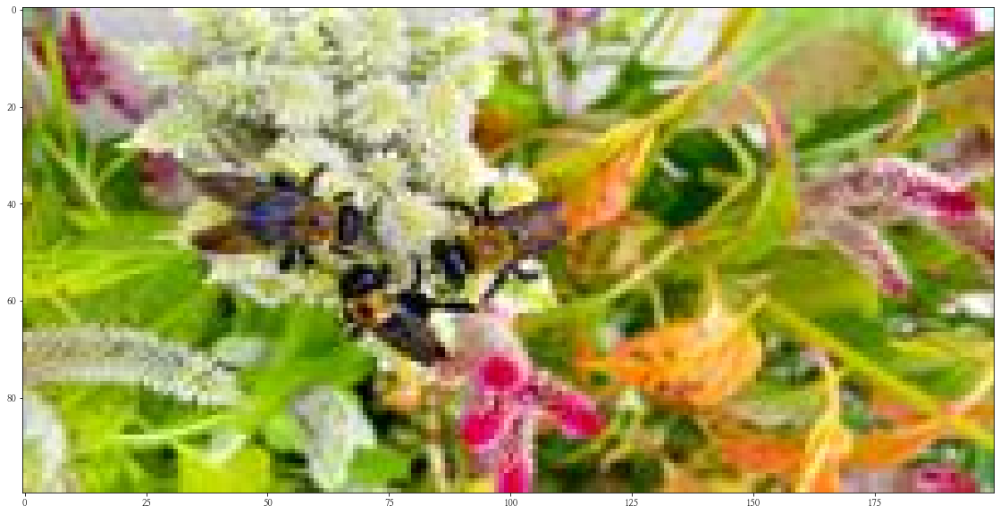

In [14]:
image_path = os.getenv('HOME') + '/aiffel/super_resolution/bee_lr.jpg'
hr = cv2.imread(image_path)
hr = cv2.cvtColor(hr, cv2.COLOR_BGR2RGB)

print(hr.shape)
plt.figure(figsize=(25, 10))
plt.imshow(hr)
plt.show()

2. 불러온 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성합니다. 이전에 사용한 apply_srgan 함수를 사용하면 쉽습니다.

In [15]:
model_file = os.getenv('HOME')+'/aiffel/super_resolution/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)

(400, 800, 3)


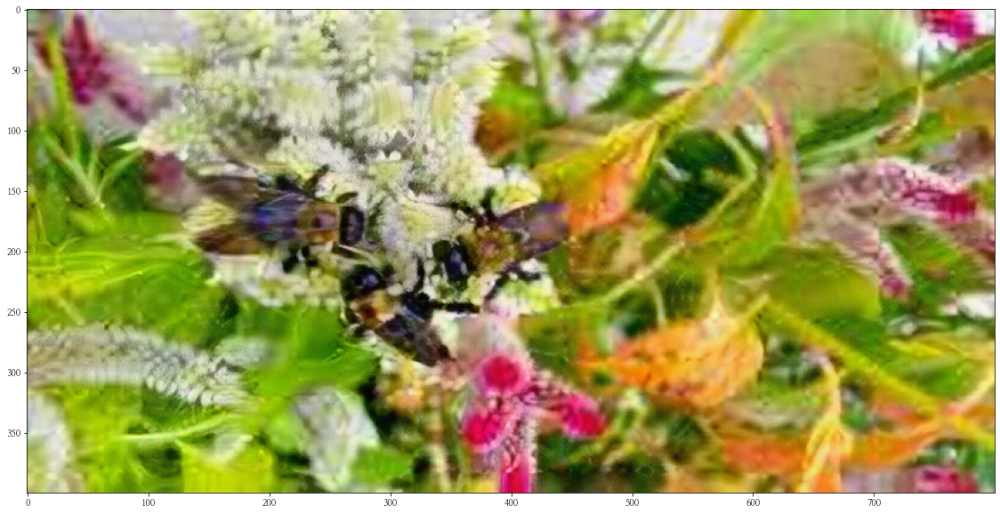

In [16]:
srgan_hr = apply_srgan(hr)
print(srgan_hr.shape)

# 시각화
plt.figure(figsize=(20,10))
plt.imshow(srgan_hr)

3. 1.에서 불러온 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. cv2.resize()를 사용해 봅시다.

(400, 800, 3)


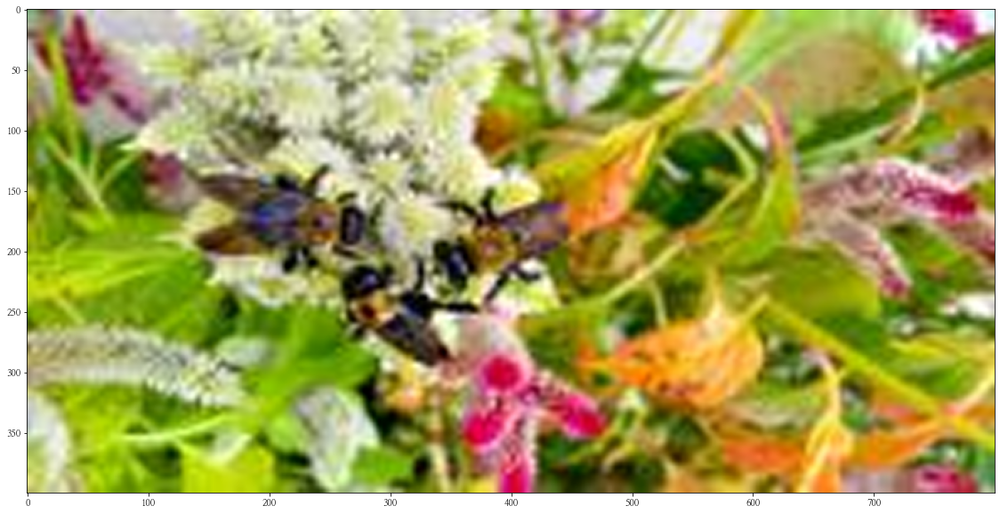

In [17]:
# 저해상도 이미지를 고해상도 이미지 크기로 bicubic interpolation
hr = np.array(hr) 
bicubic_hr = cv2.resize(
     hr,
     dsize=(srgan_hr.shape[1], srgan_hr.shape[0]),    # 고해상도 이미지 크기로 설정
     interpolation=cv2.INTER_CUBIC)        # bicubic 설정

print(bicubic_hr.shape)
# 시각화
plt.figure(figsize=(20,10))
plt.imshow(bicubic_hr)

4. 2개 이미지(3.의 Bicubic의 결과, 2.의 SRGAN의 결과)를 나란히 시각화합니다. 각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.

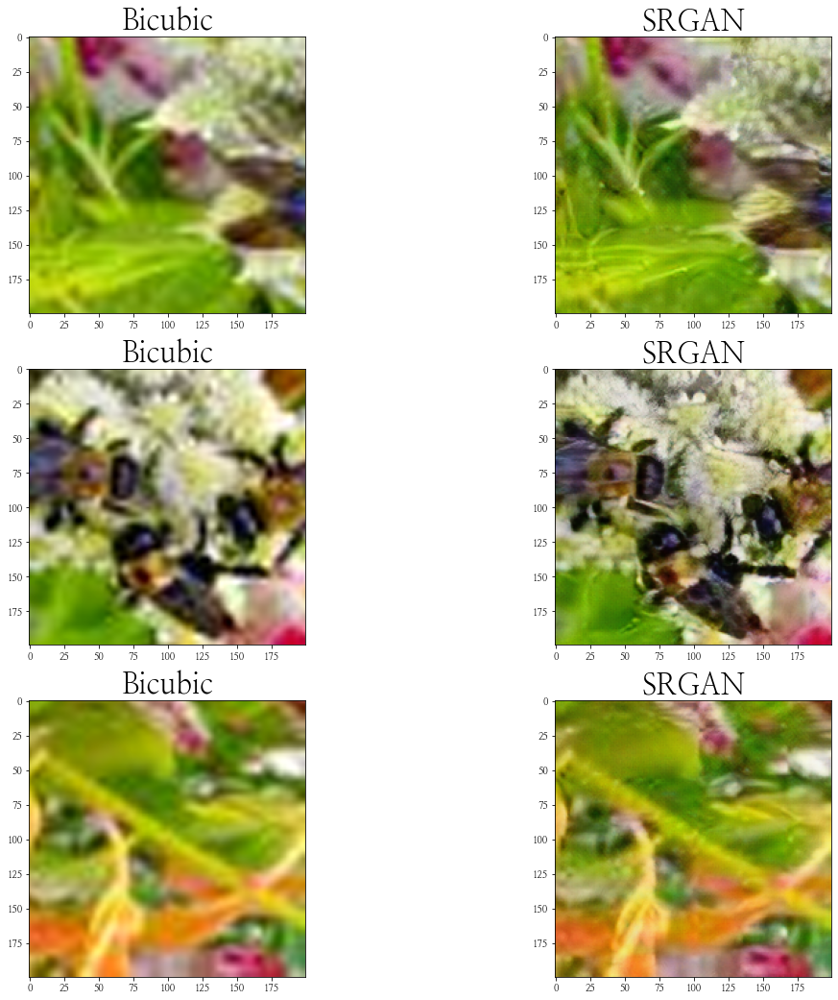

In [18]:
left_tops = [(50,0), (100,200), (200,600)]

images = []
for left_top in left_tops:
    img1 = crop(bicubic_hr, left_top, 200, 200)
    img2 = crop(srgan_hr , left_top, 200, 200)
    images.extend([img1, img2])

labels = ["Bicubic", "SRGAN"] * 3

plt.figure(figsize=(18,18))
for i in range(6):
    plt.subplot(3,2,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

5. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution했을 때 어떠한 결과가 나왔으며, 왜 이러한 결과가 출력되었는지 설명해 봅시다. (정답은 없습니다)

SRGAN을 사용한 결과와 Bicubic interpolation을 사용한 결과의 차이는 크지 않다. SRGAN이 조금 더 선명하긴 하지만 원래 해상도가 낮아서 큰 차이를 보이지 않는 것 같다. 

위에서 언급한 [논문](https://arxiv.org/pdf/1903.09922.pdf)의 한 실험에서는 흐릿한 이미지를 넣었을 때 세부적인 부분이 smooth되었다고 하였다. 

따라서 학습된 모델의 고해상도 이미지 데이터셋과 다르게 저해상도 이미지를 입력으로 넣었기 때문에 세부적인 부분을 제대로 생성하지 못하고 흐릿한 결과물을 생성해 낸 것이 아닐까 추측한다.

### 프로젝트 2 : SRGAN을 이용해 고해상도 gif 생성하기
이전 Super Resolution의 활용 사례에 대해 살펴봤을 때, 단일 이미지가 아닌 영상에 대해 Super Resolution을 적용한 사례가 있었습니다. 이번에는 이미 학습된 SRGAN을 이용해 저해상도 영상을 고해상도 영상으로 바꿔보는 프로젝트를 수행해 봅시다.

실제로 동영상의 Super Resolution은 시간 순서에 따른 다수의 프레임 정보를 고려하는 것이 더 좋지만, 처음부터 학습시키기에 많은 시간이 소요됩니다. 여기서는 이전에 사용했던 SRGAN을 이용해 한 프레임씩 고해상도 이미지로 변환 시켜 모든 프레임에 대해 적용하고, 그 프레임들을 합쳐 동영상으로 만들어 봅시다.

각 프레임들을 모아 gif 파일을 만드는데 아래 라이브러리의 설치가 필요합니다.

```$ pip install imageio```

#### 1. gif 파일 불러오기
아래 주소에 몇 개의 gif 파일이 있습니다. 이 중 하나를 골라 다운 로드하여 아래 과정을 수행합시다. (한 개 이상의 gif 파일에 대해 아래 과정을 수행해야 합니다!)

GIF files <https://drive.google.com/drive/folders/1OLsa4btdwNUiVJcOJgZe_C6-lwEoNr4e>

다운받은 gif 파일을 아래와 같은 과정을 통해 각 프레임(이미지)을 불러올 수 있습니다. frames이란 리스트 안에 각각의 프레임이 들어 있습니다.

In [55]:
import cv2

# 다운받은 파일의 경로를 설정해 주세요.
gif = cv2.VideoCapture("../super_resolution/wine_lr.gif")

isTrue = True
frames = []
while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)

print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 13
frame 크기 : (340, 355, 3)


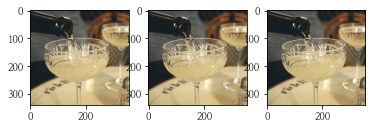

In [94]:
for i in range(3):
    plt.subplot(1,3, i+1) 
    plt.imshow(frames[i])

#### 2. 프레임별 Super Resolution 진행하기
Bicubic interpolation과 SRGAN을 이용해 각각의 가로, 세로 픽셀 수를 4배로 늘려봅시다. Super Resolution이 완료된 각각의 결과를 frames_sr이라는 리스트에 넣어주세요.

1. SRGAN

In [ ]:
for i in range(3):
    sr = apply_srgan(frames[])

In [99]:
frames_sr = [] 

for i in range(3):
    sr = apply_srgan(frames[i])
    frames_sr.append(sr)

print("frame 수 :", len(frames_sr))
print(f'frame 크기: {frames_sr[0].shape}')

frame 수 : 3
frame 크기: (1360, 1420, 3)


2. Bicubic interpolation

In [104]:
# 저해상도 이미지를 고해상도 이미지 크기로 bicubic interpolation

frames_bi = []

def apply_bicubic(image):
    bicubic_hr = cv2.resize(
         image,
         dsize=(frames_sr[0].shape[1], frames_sr[0].shape[0]),    # 고해상도 이미지 크기로 설정
         interpolation=cv2.INTER_CUBIC)        # bicubic 설정
    return bicubic_hr

for i in range(3):
    bi = apply_bicubic(frames[i])
    frames_bi.append(bi)

print("frame 수 :", len(frames_bi))
print(f'frame 크기: {frames_bi[0].shape}')

frame 수 : 3
frame 크기: (1360, 1420, 3)


#### 3. 프레임을 합쳐 gif 만들기
위에서 frame_sr을 만들었다면 아래 코드와 같이 gif 파일을 생성할 수 있습니다. Bicubic 및 SRGAN의 결과를 각각 저장하여 2개 파일을 만들어 주세요.

In [105]:
import imageio

imageio.mimsave("../super_resolution/wine_sr.gif", frames_sr)
imageio.mimsave("../super_resolution/wine_bi.gif", frames_bi)

#### 4. Jupyter notebook에 gif 표시하기
아래와 같이 다운받은 저해상도 gif 파일과 고해상도 gif 파일을 각각 jupyter 내에 출력하여 최종 제출해 주시면 됩니다. jupyter 내에 출력이 어려운 경우, GitHub에 저해상도, 고해상도 gif파일을 업로드 후 링크를 첨부해주시기바랍니다. Super Resolution이 잘 적용되었는지 시각적으로 확인하기 위해 아래의 width 옵션을 적당히 크게 해주세요. 저해상도 및 고해상도 시각화의 width 값은 같도록 설정해주세요.

## 원본

In [106]:
# from IPython.display import Image as show_gif
# show_gif("../super_resolution/wine_lr.gif") # width 는 적당히 큰 값으로 설정해주세

## SRGAN

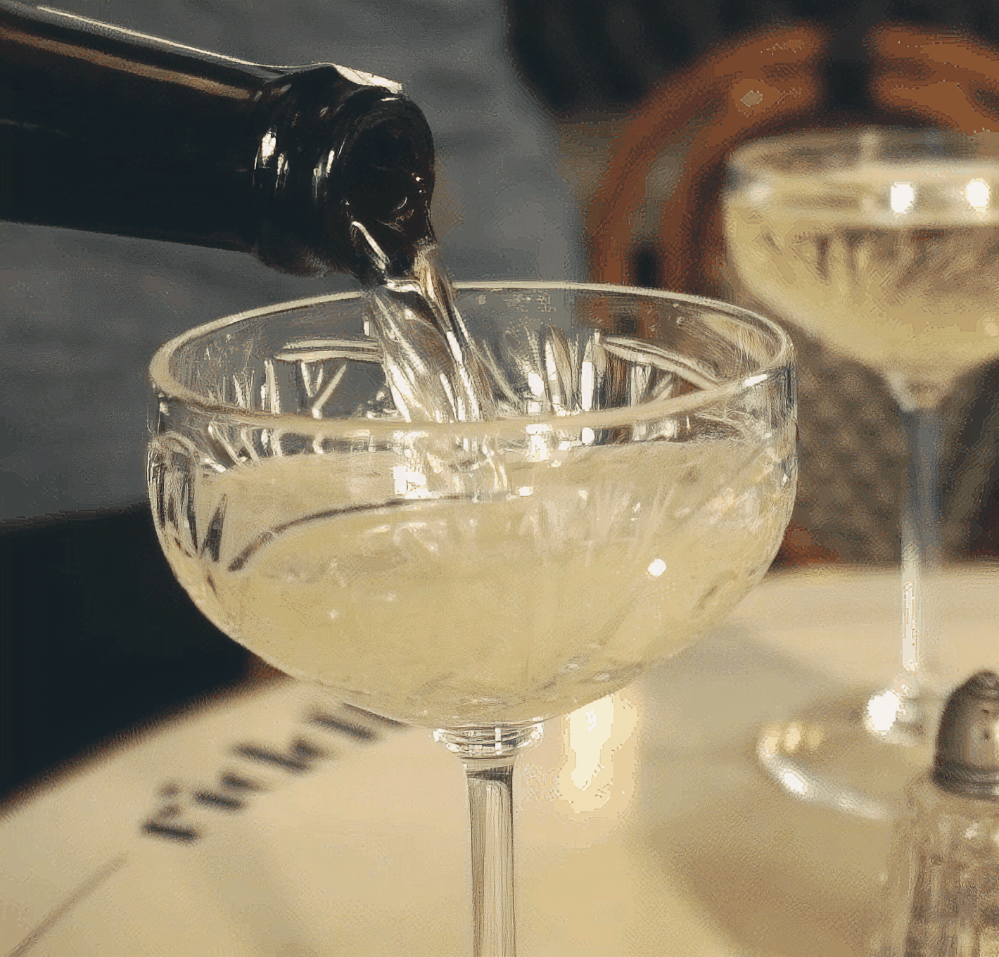

In [107]:
from IPython.display import Image as show_gif

show_gif("../super_resolution/wine_sr.gif", width=400) # width 는 적당히 큰 값으로 설정해주세

## Bicubic

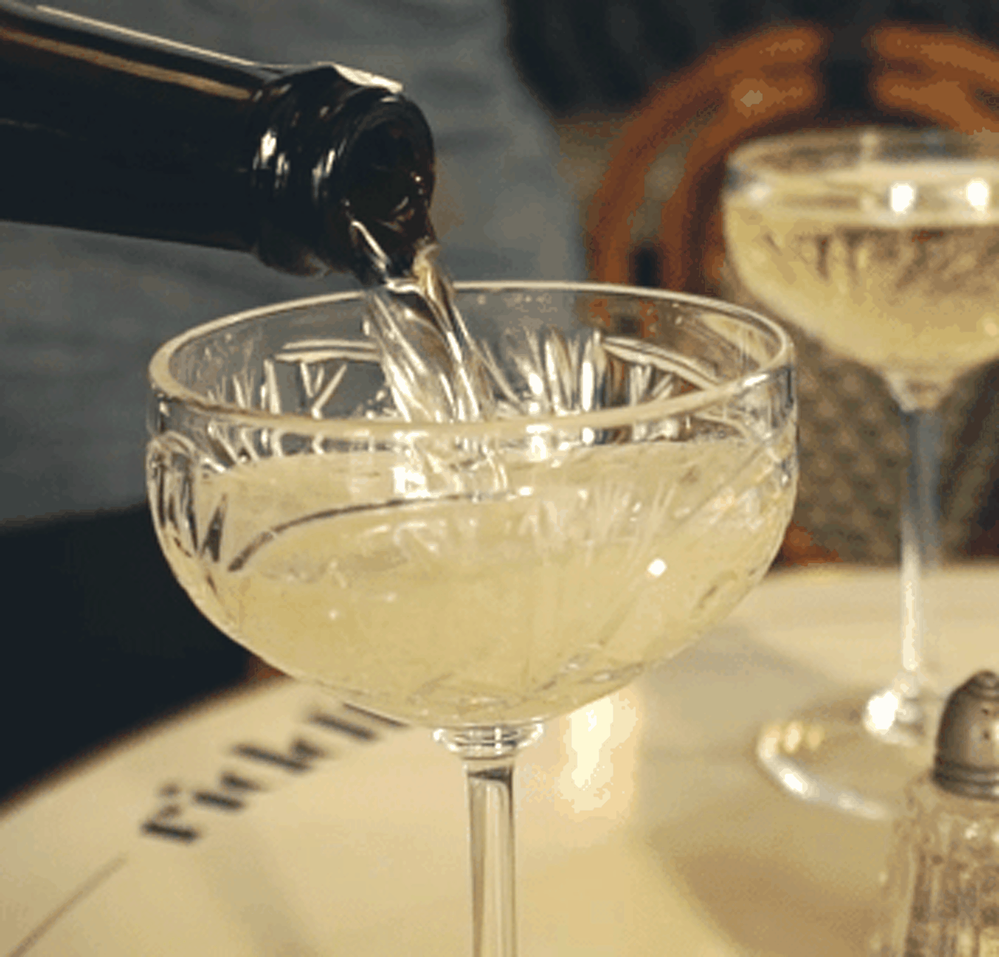

In [108]:
show_gif("../super_resolution/wine_bi.gif", width=400) # 위에서 설정한 width와 같은 값으로 설정해주세요

## 루브릭
|평가문항|	상세기준|결과|
|:------:|:--------:|:---:|
|1. SRGAN을 이용해 고해상도의 이미지를 생성하였다.|SRGAN을 통해 생성된 이미지를 제출하였다.|Y     |
|2. 다양한 해상도의 이미지에 대해 시각화를 통해 원본, SRGAN생성본, interpolation생성본을 비교분석하였다.|이미지의 특성과 super resolution 방법을 관련지어 생성 결과를 체계적으로 분석하였다.|Y   |
|3. 저해상도 gif 동영상을 고해상도 동영상으로 성공적으로 변환하였다.|저해상도 원본 gif와 생성된 고해상도 gif의 해상도 차이가 시각적으로 확인 가능하다.| Y    |

## 후기
### 이번 프로젝트에서 어려웠던 점
- 처음 프로젝트를 시작할 때 자꾸만 에러 메시지가 이미지를 작은 사이즈로 바꾸는 등 다양한 시도를 했었다. 혹시나 싶어 노트북을 재부팅시키고 나니 제대로 동작했다.
- gif 파일의 용량이 커서 고생을 했다. 3장으로 gif를 만드는 것도 잘 몰라서 헤매다가 도움을 받아서 해결했다. 또한 깃헙에 용량이 큰 파일을 올린 후로 커밋이 안 되어서 고생했다. 구글링을 했지만 결국 해결을 하지 못하였다. 

### 프로젝트를 진행하면서 알게된 점
- Interpolation과 SRGAN의 동작 원리를 알게 되었다. 
- SR의 원리와 사용 분야에 대해서 알게 되었다. 

### 프로젝트를 진행하면서 아직 모호한 점
- SRGAN을 사용하여 저해상도 이미지를 고해상도 이미지로 변환하였어도 원본보다는 좋은 결과를 내지 못했다. 저해상도 이미지를 넣었을 때는 SRGAN을 사용해도 고해상도 이미지를 생성하지 못했다. 그 이유를 알아보고자 자료를 찾았으나 만족할 만한 자료를 찾지 못했다. 결국 1개의 논문을 발견하였으나 그 이유가 맞는 것인지는 모르겠다.

### 자기 다짐
이번 프로젝트는 이전에 배웠던 코드를 사용해서 이해하는데 코드 부분에서는 어렵지 않게 이해할 수 있었다. 이론 역시 이전에 배웠던 부분과 겹치는 부분이 많아서 크게 어렵지는 않았다. 그러나 SRGAN의 세부적인 내용은 논문리뷰를 보아도 제대로 이해하지 못하는 부분이 많았다. 노드를 공부하면서 설명이 부족한 부분을 발견하는데, 앞으로는 노드만 의존하지 말고 다른 자료들도 찾아보면서 공부해야겠다는 생각이 든다.   